# Importation biliothèques

In [65]:
import pandas as pd
from math import floor
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import pandas as pd
from math import floor
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from scipy import stats
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.preprocessing import LabelEncoder
import psycopg2
import yaml

# Chargement des données

In [3]:
with open(r'.\project_config.yml') as file:
    dbInfo = yaml.load(file, Loader=yaml.FullLoader)
    DB_HOST = dbInfo["project-database"]["hostname"]
    DB_NAME = dbInfo["project-database"]["name"]
    DB_USER = dbInfo["project-database"]["user"]
    DB_PASSWORD = dbInfo["project-database"]["password"]

In [4]:
table_bdf = "epa_bdf_normalisation"
try:
    connection = psycopg2.connect(user = DB_USER,
                                  password = DB_PASSWORD,
                                  host = DB_HOST,
                                  port = "5432",
                                  database = DB_NAME)
    cursor = connection.cursor()

    query1 = """SELECT * FROM public.""" + table_bdf +""" ;"""
    query2 = """SELECT * FROM public.""" + table_bdf +""" ;"""
    cursor.execute(query1)
    record_epa_bdf = cursor.fetchall()
    columns_bdf = cursor.description

    cursor.execute(query2)
    record_epa_emission = cursor.fetchall()
    columns_emission = cursor.description

    print("DONE")
except (Exception, psycopg2.Error) as error :
    print ("Error while connecting to PostgreSQL", error)
finally:
    #closing database connection.
        if(connection):
            cursor.close()
            connection.close()
            print("PostgreSQL connection is closed")

DONE
PostgreSQL connection is closed


In [5]:
columns_epa_bdf = [col[0] for col in columns_bdf]
df_epa_bdf = pd.DataFrame(columns=columns_epa_bdf, data= record_epa_bdf)

columns_epa_emission = [col[0] for col in columns_emission]
df_epa_emission = pd.DataFrame(columns=columns_epa_emission, data= record_epa_emission)

## Chargement des variables

In [42]:
list_columns_id = ["file", "test date", "run id", "source category", "source subcategory"]

substances = ['2378-TCDD', '12378-PCDD', '123478-HxCDD', '123678-HxCDD',
       '123789-HxCDD', '1234678-HpCDD', 'OCDD', '2378-TCDF', '12378-PeCDF',
       '23478-PeCDF', '123478-HxCDF', '123678-HxCDF', '234678-HxCDF',
       '123789-HxCDF', '1234678-HpCDF', '1234789-HpCDF', 'OCDF']

total_homologue = ['Total TCDD', 'Total TCDF',
         'Total PCDD', 'Total PeCDF',
         'Total HxCDD', 'Total HxCDF',
         'Total HpCDD', 'Total HpCDF',
         'OCDD', 'OCDF']

total = ['Total DIOXINE', 'Total FURANE', 'Total DIOXINE FURANE']

## Comparaison entre distribution

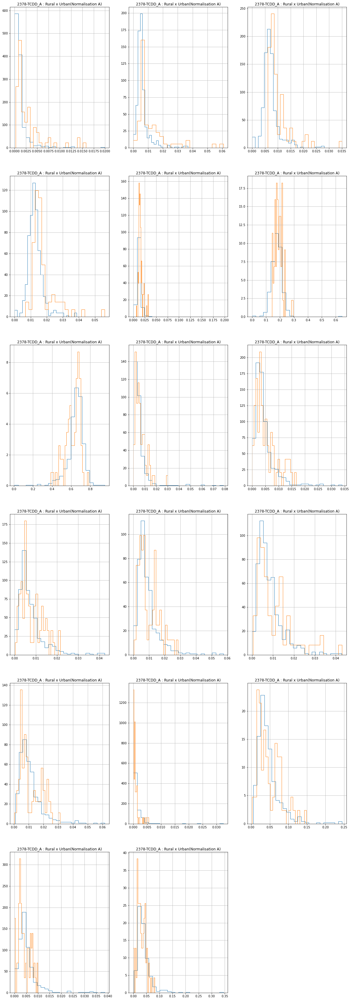

In [59]:
f = plt.figure(figsize=(20, 60))
area1 = "Rural"
area2 = "Urban"
m1 = []
m2 = []
df_methodeA = df_epa_bdf
PRO_A = [sub + '_A' for sub in substances]
for (i, sub) in enumerate(PRO_A):
    df1 = df_methodeA[df_methodeA["Type"] == area1][[sub]].dropna()
    df2 = df_methodeA[df_methodeA["Type"] == area2][[sub]].dropna()
    ax = f.add_subplot(6,3, i + 1)
    ax = plt.title(profile + " : " + area1 + " x " + area2 + "(Normalisation A)")
    nb_bins = int(max(len(df1), len(df2)) * 0.05)
    m1.append(np.mean(df1[sub].values))
    m2.append(np.mean(df2[sub].values))
    ax = plt.hist(df1[sub].values, bins = nb_bins, label = area1, histtype = "step", density = True)
    ax = plt.hist(df2[sub].values, bins = nb_bins, label = area2, histtype = "step", density = True)
    plt.grid()
plt.show()

## Pairplot

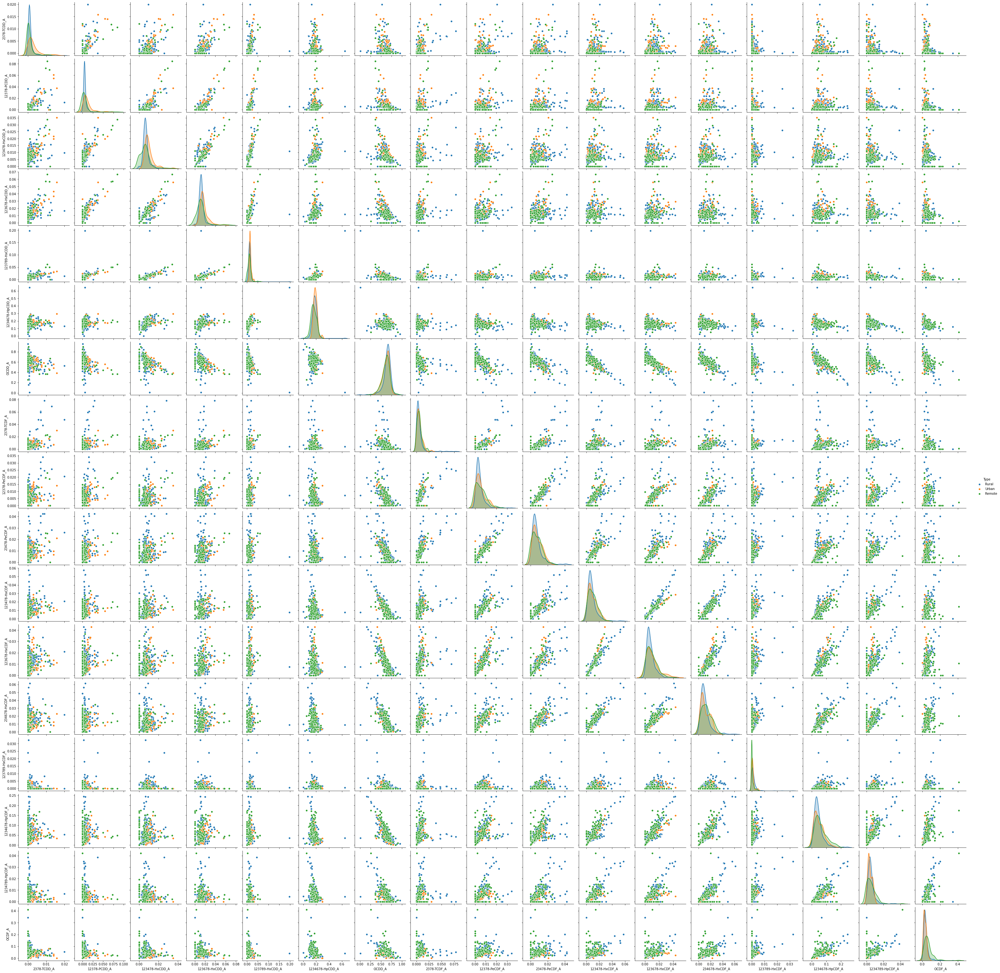

In [60]:
sns.pairplot(df_methodeA[PRO_A + ["Type"]], hue = "Type", dropna=True)

## LDA (2 à 2)

In [74]:
area1 = "Rural"
area2 = "Urban"
df_analyse_final = df_methodeA
X = df_analyse_final[(df_analyse_final["Type"] == area1) | (df_analyse_final["Type"] == area2)][PRO_A]
y = df_analyse_final[(df_analyse_final["Type"] == area1) | (df_analyse_final["Type"] == area2)]["Type"]
enc = LabelEncoder()
label_encoder = enc.fit(y)
y = label_encoder.transform(y) + 1
label_dict = {i : area for i, area in enumerate(list_areas)}

In [75]:
sklearn_lda = LDA(n_components=1)
X_lda_sklearn = sklearn_lda.fit_transform(X, y)

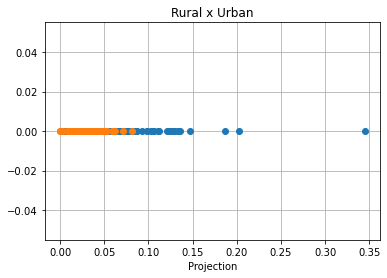

In [76]:
df_1 = []
df_2 = []
for (value, area) in zip(X_lda_sklearn, df_analyse_final["Type"]):
    if(area == "Rural"):
        df_1.append(value[0])
    else:
        df_2.append(value[0])

plt.plot(df1, np.zeros(len(df1)), "o", label="Rural")
plt.plot(df2, np.zeros(len(df2)), "o", label="Urban")
plt.title(area1 + " x " + area2)
plt.xlabel("Projection")
plt.grid()
plt.show()

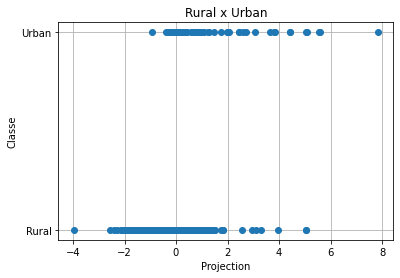

In [78]:
plt.plot(X_lda_sklearn, df_analyse_final[(df_analyse_final["Type"] == area1) | (df_analyse_final["Type"] == area2)]["Type"], 'o')
plt.title(area1 + " x " + area2)
plt.xlabel("Projection")
plt.ylabel("Classe")
plt.grid()
plt.show()

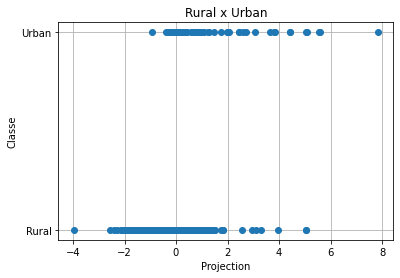

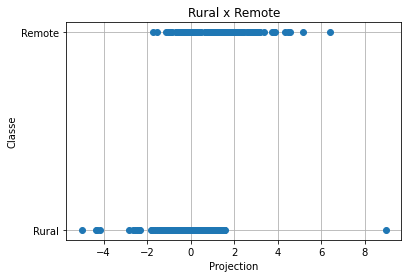

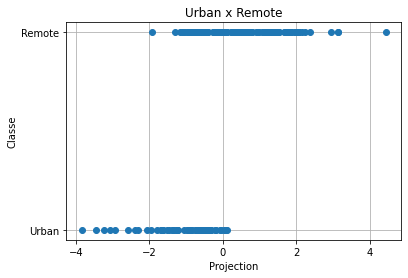

In [91]:
list_areas = pd.unique(df_methodeA["Type"])
for (i, area_i) in enumerate(list_areas):
    for (j, area_j) in enumerate(list_areas):
        if (i < j):
            data = df_analyse_final[(df_analyse_final["Type"] == area_i) | (df_analyse_final["Type"] == area_j)]
            X = data[PRO_A]
            y = data["Type"]

            enc = LabelEncoder()
            label_encoder = enc.fit(y)

            y = label_encoder.transform(y) + 1
            label_dict = {1: area_i, 2: area_j}
            sklearn_lda = LDA(n_components=len(pd.unique(y)) - 1)
            X_lda_sklearn = sklearn_lda.fit_transform(X, y)

            plt.plot(X_lda_sklearn, data["Type"], 'o')
            plt.title(area_i + " x " + area_j)
            plt.xlabel("Projection")
            plt.ylabel("Classe")
            plt.grid()
            plt.show()

## LDA globale

In [83]:
X = df_analyse_final[PRO_A]
y = df_analyse_final["Type"]
enc = LabelEncoder()
label_encoder = enc.fit(y)
y = label_encoder.transform(y) + 1
label_dict = {i : area for i, area in enumerate(list_areas)}

In [84]:
sklearn_lda = LDA(n_components=2)
X_lda_sklearn = sklearn_lda.fit_transform(X, y)

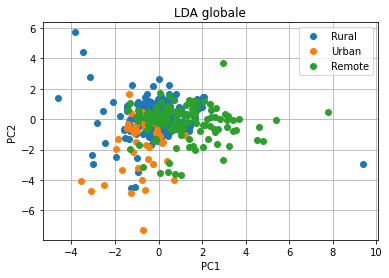

In [85]:
df_1 = []
df_2 = []
df_3 = []
for (value, area) in zip(X_lda_sklearn, df_analyse_final["Type"]):
    if(area == "Rural"):
        df_1.append(list(value))
    elif(area == "Urban"):
        df_2.append(list(value))
    else:
        df_3.append(list(value))
plt.plot([i[0] for i in df_1], [i[1] for i in df_1], "o", label="Rural")
plt.plot([i[0] for i in df_2], [i[1] for i in df_2], "o", label="Urban")
plt.plot([i[0] for i in df_3], [i[1] for i in df_3], "o", label="Remote")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.title("LDA globale")
plt.grid()
plt.show()

In [86]:
print("Vecteur propre :\n", sklearn_lda.scalings_)

Vecteur propre :
 [[-262.5114791  -191.12787537]
 [ -52.70970347  -15.63121717]
 [   7.78170149 -124.08615261]
 [  88.69435407   24.77464899]
 [   7.21221      41.63292327]
 [  -8.82031857   -7.24575957]
 [  -2.41957616    1.52422915]
 [  18.03470894   33.85058475]
 [ 312.97065942    7.51808443]
 [-178.49393604   76.0453469 ]
 [  27.46586023  149.25562826]
 [-187.8758614  -316.61354083]
 [  31.20724772   -4.22473159]
 [-201.18148758  143.31183202]
 [  19.00043367    9.80024131]
 [ -61.69663983   69.5231451 ]
 [  19.11291291  -11.71147896]]


# Normalisation C

## Comparaison entre distribution

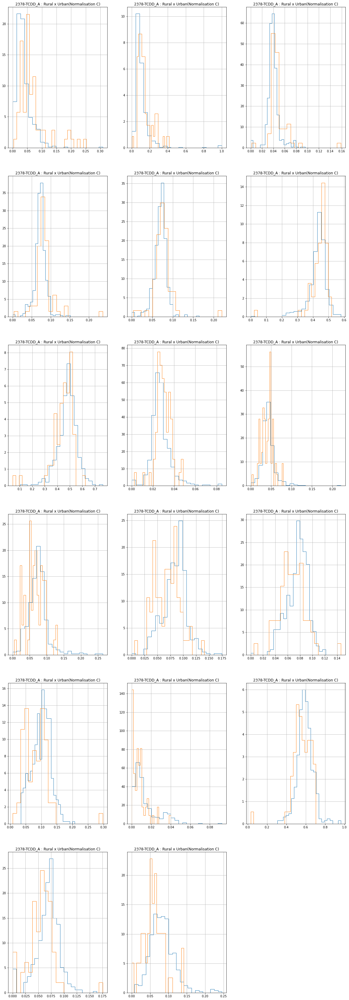

In [103]:
f = plt.figure(figsize=(20, 60))
area1 = "Rural"
area2 = "Urban"
m1 = []
m2 = []
df_methodeC = df_epa_bdf.dropna()
PRO_C = [sub + "_C" for sub in substances]
for (i, sub) in enumerate(PRO_C):
    df1 = df_methodeC[df_methodeC["Type"] == area1][[sub]].dropna()
    df2 = df_methodeC[df_methodeC["Type"] == area2][[sub]].dropna()
    ax = f.add_subplot(6,3, i + 1)
    ax = plt.title(profile + " : " + area1 + " x " + area2 + "(Normalisation C)")
    nb_bins = int(max(len(df1), len(df2)) * 0.05)
    m1.append(np.mean(df1[sub].values))
    m2.append(np.mean(df2[sub].values))
    ax = plt.hist(df1[sub].values, bins = nb_bins, label = area1, histtype = "step", density = True)
    ax = plt.hist(df2[sub].values, bins = nb_bins, label = area2, histtype = "step", density = True)
    plt.grid()
plt.show()

## LDA (2 à 2)

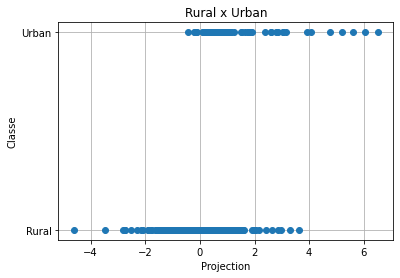

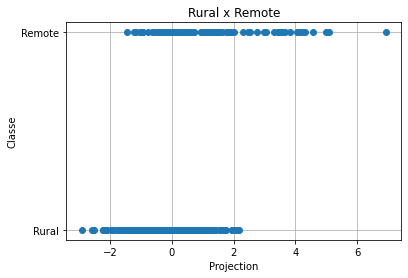

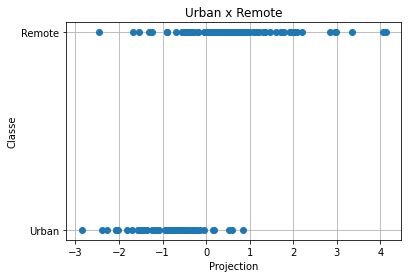

In [104]:
df_analyse_final = df_methodeC
list_areas = pd.unique(df_analyse_final["Type"])
for (i, area_i) in enumerate(list_areas):
    for (j, area_j) in enumerate(list_areas):
        if (i < j):
            data = df_analyse_final[(df_analyse_final["Type"] == area_i) | (df_analyse_final["Type"] == area_j)]
            X = data[PRO_C]
            y = data["Type"]

            enc = LabelEncoder()
            label_encoder = enc.fit(y)

            y = label_encoder.transform(y) + 1
            label_dict = {1: area_i, 2: area_j}
            sklearn_lda = LDA(n_components=len(pd.unique(y)) - 1)
            X_lda_sklearn = sklearn_lda.fit_transform(X, y)

            plt.plot(X_lda_sklearn, data["Type"], 'o')
            plt.title(area_i + " x " + area_j)
            plt.xlabel("Projection")
            plt.ylabel("Classe")
            plt.grid()
            plt.show()

## LDA globale

In [105]:
X = df_analyse_final[PRO_C]
y = df_analyse_final["Type"]
enc = LabelEncoder()
label_encoder = enc.fit(y)
y = label_encoder.transform(y) + 1
label_dict = {i : area for i, area in enumerate(list_areas)}

In [106]:
sklearn_lda = LDA(n_components=2)
X_lda_sklearn = sklearn_lda.fit_transform(X, y)

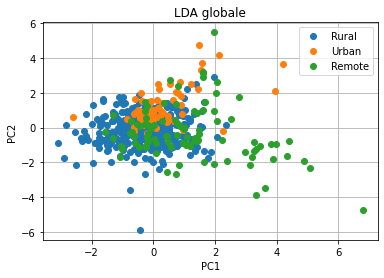

In [108]:
df_1 = []
df_2 = []
df_3 = []
for (value, area) in zip(X_lda_sklearn, df_analyse_final["Type"]):
    if(area == "Rural"):
        df_1.append(list(value))
    elif(area == "Urban"):
        df_2.append(list(value))
    else:
        df_3.append(list(value))
plt.plot([i[0] for i in df_1], [i[1] for i in df_1], "o", label="Rural")
plt.plot([i[0] for i in df_2], [i[1] for i in df_2], "o", label="Urban")
plt.plot([i[0] for i in df_3], [i[1] for i in df_3], "o", label="Remote")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.title("LDA globale")
plt.grid()
plt.show()

In [109]:
sklearn_lda.scalings_

array([[ 2.48902348e+00,  9.21954738e+00],
       [ 1.94095759e-01, -1.62631320e-02],
       [ 1.85680468e+01,  3.46143600e+01],
       [ 8.65493436e+00, -3.24763237e+00],
       [ 3.13182014e+00, -1.79851465e+00],
       [-2.21056185e+00,  5.06095300e+00],
       [-7.10003516e+00, -1.87325518e+00],
       [-1.80696172e+01,  2.24676272e+01],
       [ 1.07780683e+01, -6.07451840e+00],
       [-1.10175973e+01,  4.10714306e+00],
       [-1.91094951e+01, -2.41090513e+01],
       [ 5.13220827e-01,  2.91217911e+01],
       [ 1.48282488e+01, -7.18524536e-01],
       [-4.61866167e+01, -1.03895154e+01],
       [ 4.68739445e-01, -3.33245720e+00],
       [-1.13081956e+00, -5.25509206e+00],
       [ 1.46467203e+01, -1.00072883e+01]])

# Normalisation A x C

### LDA 2 à 2

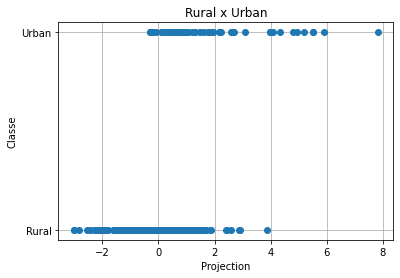

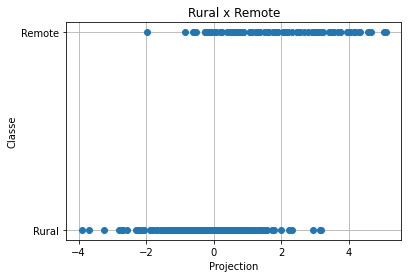

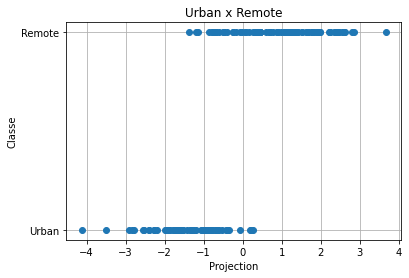

In [113]:
df_analyse_final = df_epa_bdf.dropna()
list_areas = pd.unique(df_analyse_final["Type"])
for (i, area_i) in enumerate(list_areas):
    for (j, area_j) in enumerate(list_areas):
        if (i < j):
            data = df_analyse_final[(df_analyse_final["Type"] == area_i) | (df_analyse_final["Type"] == area_j)]
            X = data[PRO_A + PRO_C]
            y = data["Type"]

            enc = LabelEncoder()
            label_encoder = enc.fit(y)
            y = label_encoder.transform(y) + 1
            label_dict = {1: area_i, 2: area_j}

            sklearn_lda = LDA(n_components=len(pd.unique(y)) - 1)
            X_lda_sklearn = sklearn_lda.fit_transform(X, y)

            plt.plot(X_lda_sklearn, data["Type"], 'o')
            plt.title(area_i + " x " + area_j)
            plt.xlabel("Projection")
            plt.ylabel("Classe")
            plt.grid()
            plt.show()

### LDA globale

In [115]:
X = df_analyse_final[PRO_A + PRO_C]
y = df_analyse_final["Type"]
enc = LabelEncoder()
label_encoder = enc.fit(y)
y = label_encoder.transform(y) + 1
label_dict = {i : area for i, area in enumerate(list_areas)}

sklearn_lda = LDA(n_components=2)
X_lda_sklearn = sklearn_lda.fit_transform(X, y)

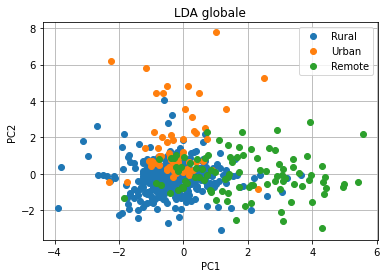

In [116]:
df_1 = []
df_2 = []
df_3 = []
for (value, area) in zip(X_lda_sklearn, df_analyse_final["Type"]):
    if(area == "Rural"):
        df_1.append(list(value))
    elif(area == "Urban"):
        df_2.append(list(value))
    else:
        df_3.append(list(value))
plt.plot([i[0] for i in df_1], [i[1] for i in df_1], "o", label="Rural")
plt.plot([i[0] for i in df_2], [i[1] for i in df_2], "o", label="Urban")
plt.plot([i[0] for i in df_3], [i[1] for i in df_3], "o", label="Remote")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.title("LDA globale")
plt.grid()
plt.show()